In [97]:
# Import all the libraries which are needed for exploratory data analysis
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
# PCA Analysis
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
#Another Solution
from sklearn.preprocessing import MinMaxScaler
%matplotlib inline

In [98]:
#Set max row display
pd.set_option('display.max_row',100)

In [99]:
#Set max column width to 50
pd.set_option('display.max_columns',50)

In [100]:
#Read the data
ccdefault=pd.read_csv('UCI_Credit_Card.csv')

In [101]:
#Explore the data
ccdefault.head(3)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0


In [102]:
#Metadata Information
ccdefault.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
ID                            30000 non-null int64
LIMIT_BAL                     30000 non-null float64
SEX                           30000 non-null int64
EDUCATION                     30000 non-null int64
MARRIAGE                      30000 non-null int64
AGE                           30000 non-null int64
PAY_0                         30000 non-null int64
PAY_2                         30000 non-null int64
PAY_3                         30000 non-null int64
PAY_4                         30000 non-null int64
PAY_5                         30000 non-null int64
PAY_6                         30000 non-null int64
BILL_AMT1                     30000 non-null float64
BILL_AMT2                     30000 non-null float64
BILL_AMT3                     30000 non-null float64
BILL_AMT4                     30000 non-null float64
BILL_AMT5                     30000 non-null float64
BILL_AMT6   

In [103]:
#Statistical Information
ccdefault.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,-0.266200,-0.291100,51223.330900,49179.075167,4.701315e+04,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,1.133187,1.149988,73635.860576,71173.768783,6.934939e+04,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3558.750000,2984.750000,2.666250e+03,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22381.500000,21200.000000,2.008850e+04,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,67091.000000,64006.250000,6.016475e+04,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


In [104]:
#Dataset Shape
ccdefault.shape

(30000, 25)

In [105]:
#Check for any nulls or missing values
total = ccdefault.isnull().sum().sort_values(ascending = False)
percent = (ccdefault.isnull().sum()/ccdefault.isnull().count()*100).sort_values(ascending = False)
pd.concat([total, percent], axis=1, keys=['Total', 'Percent']).transpose()

,default.payment.next.month,PAY_6,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,BILL_AMT1,PAY_AMT6,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,ID
Total,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Percent,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [106]:
#rename column names
ccdefault.rename(columns={'default.payment.next.month':'DEFAULT'},inplace=True)

In [107]:
#find unique values
ccdefault.AGE.unique()

array([24, 26, 34, 37, 57, 29, 23, 28, 35, 51, 41, 30, 49, 39, 40, 27, 47,
       33, 32, 54, 58, 22, 25, 31, 46, 42, 43, 45, 56, 44, 53, 38, 63, 36,
       52, 48, 55, 60, 50, 75, 61, 73, 59, 21, 67, 66, 62, 70, 72, 64, 65,
       71, 69, 68, 79, 74], dtype=int64)

In [108]:
#find unique values
ccdefault.DEFAULT.unique()

array([1, 0], dtype=int64)

In [14]:
#find unique values
ccdefault.LIMIT_BAL.unique()
#find unique values
ccdefault.LIMIT_BAL.value_counts()

50000.0      3365
20000.0      1976
30000.0      1610
80000.0      1567
200000.0     1528
150000.0     1110
100000.0     1048
180000.0      995
360000.0      881
60000.0       825
140000.0      749
230000.0      737
70000.0       731
210000.0      730
130000.0      729
120000.0      726
500000.0      722
160000.0      694
90000.0       651
240000.0      619
110000.0      588
300000.0      554
170000.0      532
260000.0      521
280000.0      493
10000.0       493
220000.0      469
250000.0      350
290000.0      348
320000.0      312
310000.0      272
400000.0      271
270000.0      238
350000.0      231
40000.0       230
190000.0      229
340000.0      217
390000.0      174
330000.0      173
420000.0      168
450000.0      161
380000.0      156
440000.0       83
430000.0       83
460000.0       80
470000.0       80
480000.0       79
410000.0       78
370000.0       71
490000.0       64
550000.0       21
520000.0       20
510000.0       19
600000.0       16
610000.0       11
580000.0  

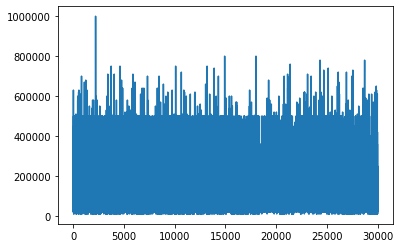

In [14]:
#Basic Data Visualizations to understand the data
plt.plot(ccdefault['LIMIT_BAL'])

References
https://towardsdatascience.com/data-visualization-using-matplotlib-16f1aae5ce70

In [15]:
ccdefault.head(3)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
0,1,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0


C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\envs\ML7331\lib\site-packages\statsmodels\nonparametric\kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\envs\ML7331\lib\site-packages\statsmodels\nonparametric\kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


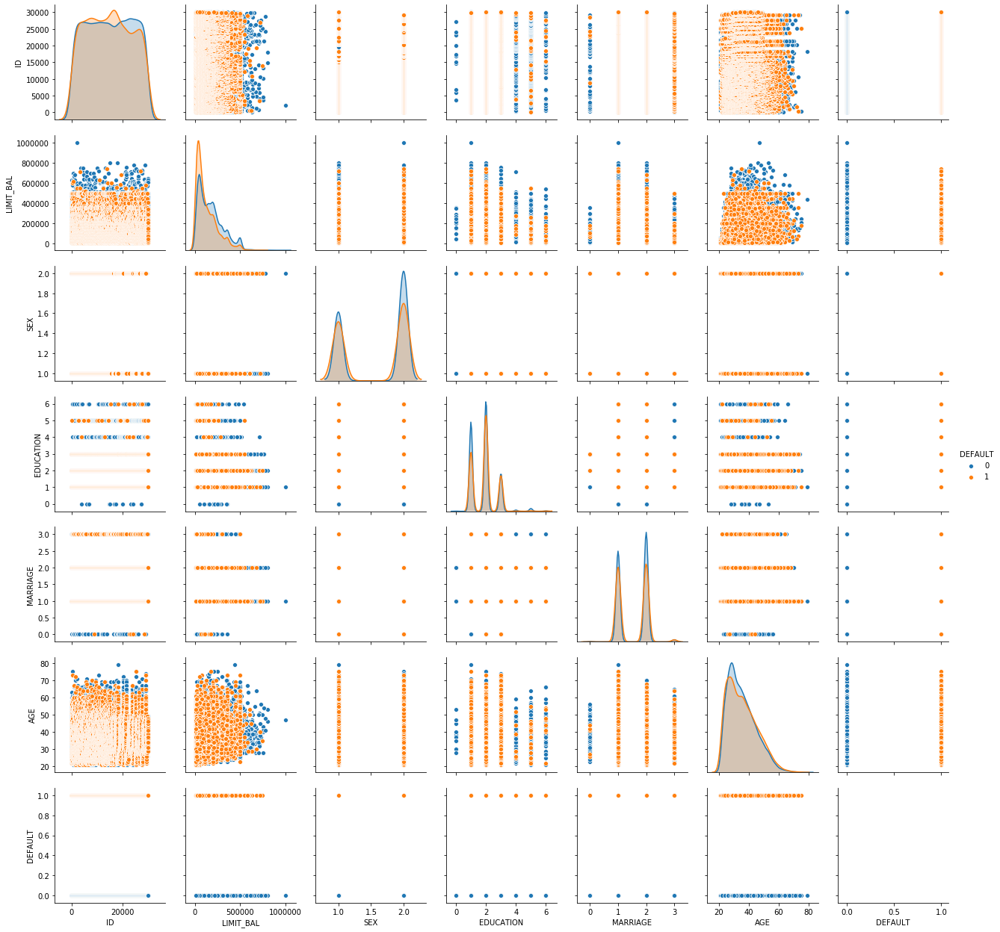

In [17]:
sns.pairplot(data=ccdefault[["ID","LIMIT_BAL","SEX","EDUCATION","MARRIAGE","AGE","DEFAULT"]],
             hue="DEFAULT", dropna=True)

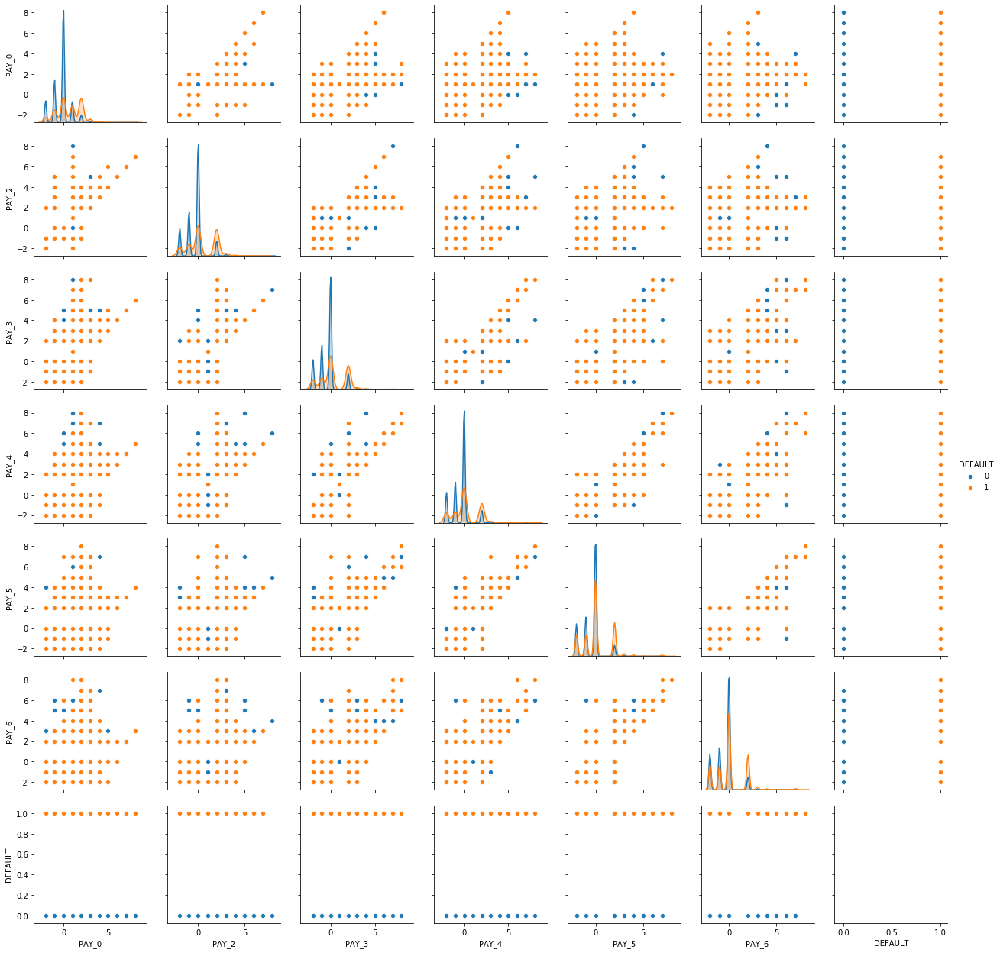

In [18]:
sns.pairplot(data=ccdefault[["PAY_0","PAY_2","PAY_3","PAY_4","PAY_5","PAY_6","DEFAULT"]],
             hue="DEFAULT", dropna=True)

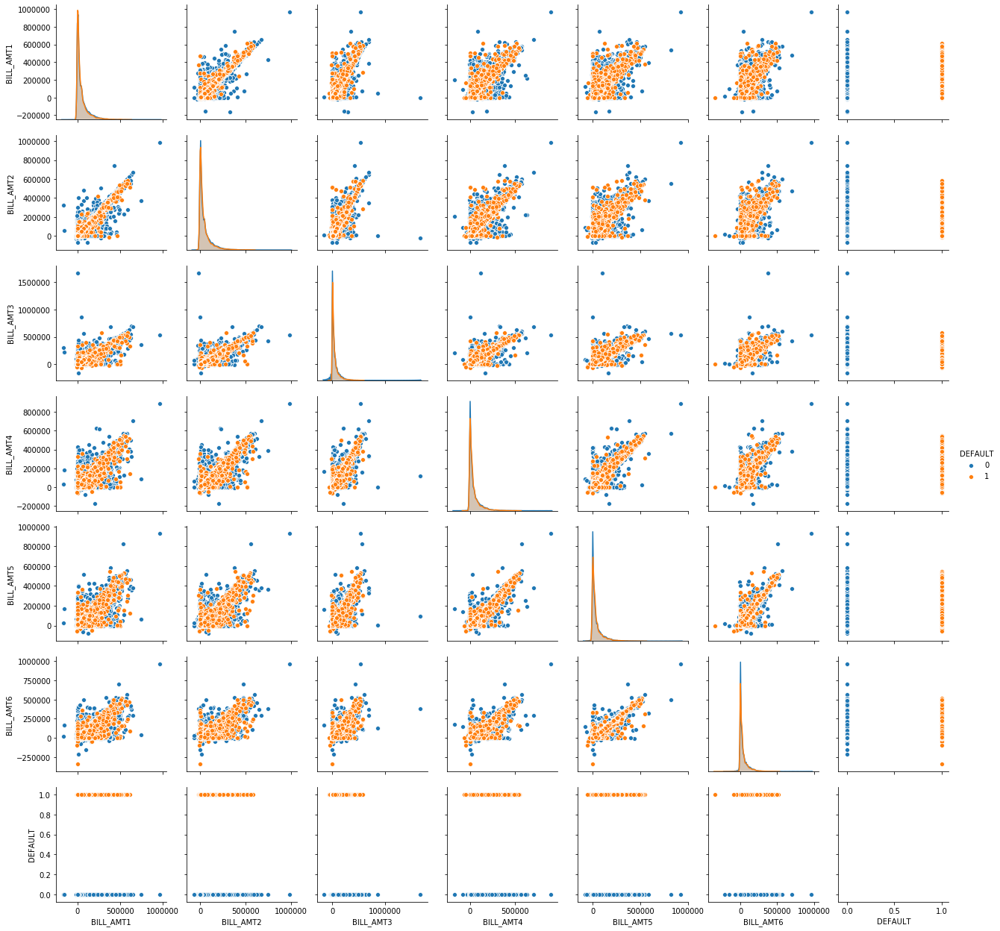

In [19]:
sns.pairplot(data=ccdefault[["BILL_AMT1","BILL_AMT2","BILL_AMT3","BILL_AMT4","BILL_AMT5","BILL_AMT6","DEFAULT"]],
             hue="DEFAULT", dropna=True)

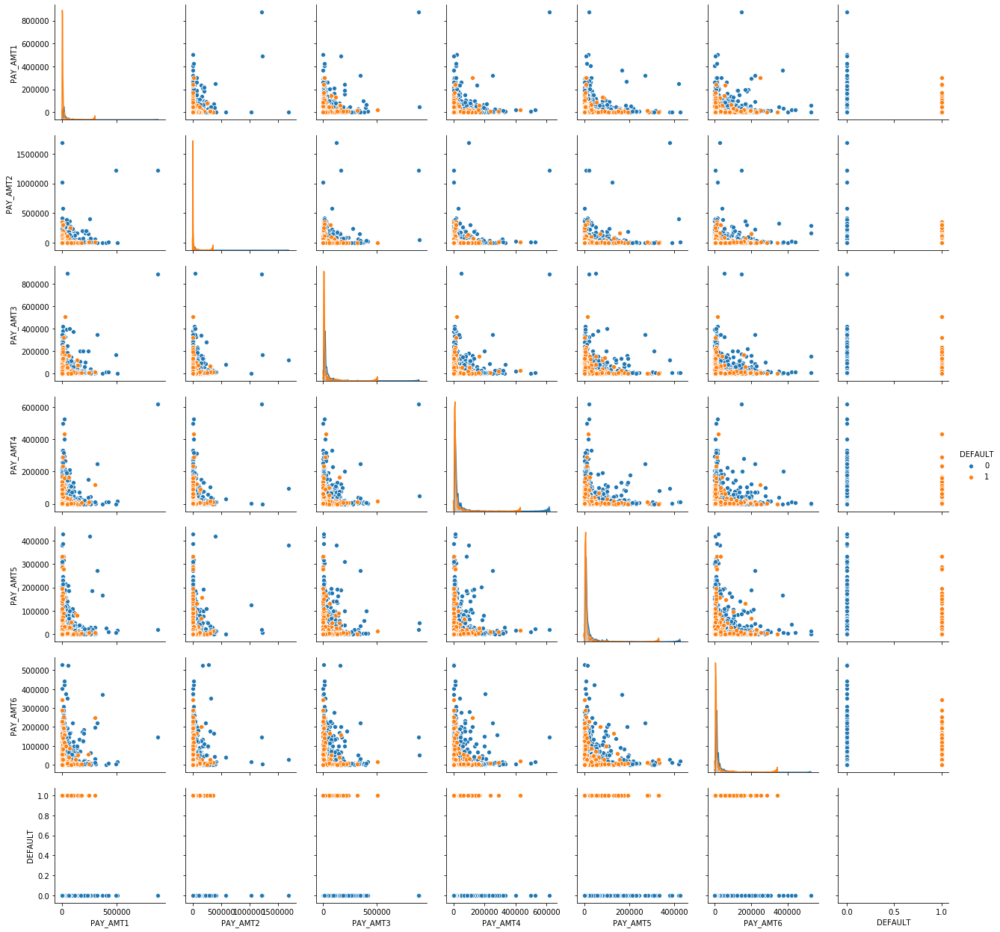

In [20]:
sns.pairplot(data=ccdefault[["PAY_AMT1","PAY_AMT2","PAY_AMT3","PAY_AMT4","PAY_AMT5","PAY_AMT6","DEFAULT"]],
             hue="DEFAULT", dropna=True)

C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\envs\ML7331\lib\site-packages\statsmodels\nonparametric\kernels.py:128: RuntimeWarning: divide by zero encountered in true_divide
  return (1. / np.sqrt(2 * np.pi)) * np.exp(-(Xi - x)**2 / (h**2 * 2.))
C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\envs\ML7331\lib\site-packages\statsmodels\nonparametric\kernels.py:128: RuntimeWarning: invalid value encountered in true_divide
  return (1. / np.sqrt(2 * np.pi)) * np.exp(-(Xi - x)**2 / (h**2 * 2.))
C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\envs\ML7331\lib\site-packages\statsmodels\nonparametric\_kernel_base.py:516: RuntimeWarning: invalid value encountered in true_divide
  dens = Kval.prod(axis=1) / np.prod(bw[iscontinuous])
C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\envs\ML7331\lib\site-packages\matplotlib\contour.py:1520: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
C:\Users\dkunupudi\AppData\Local\Continuum\anaconda

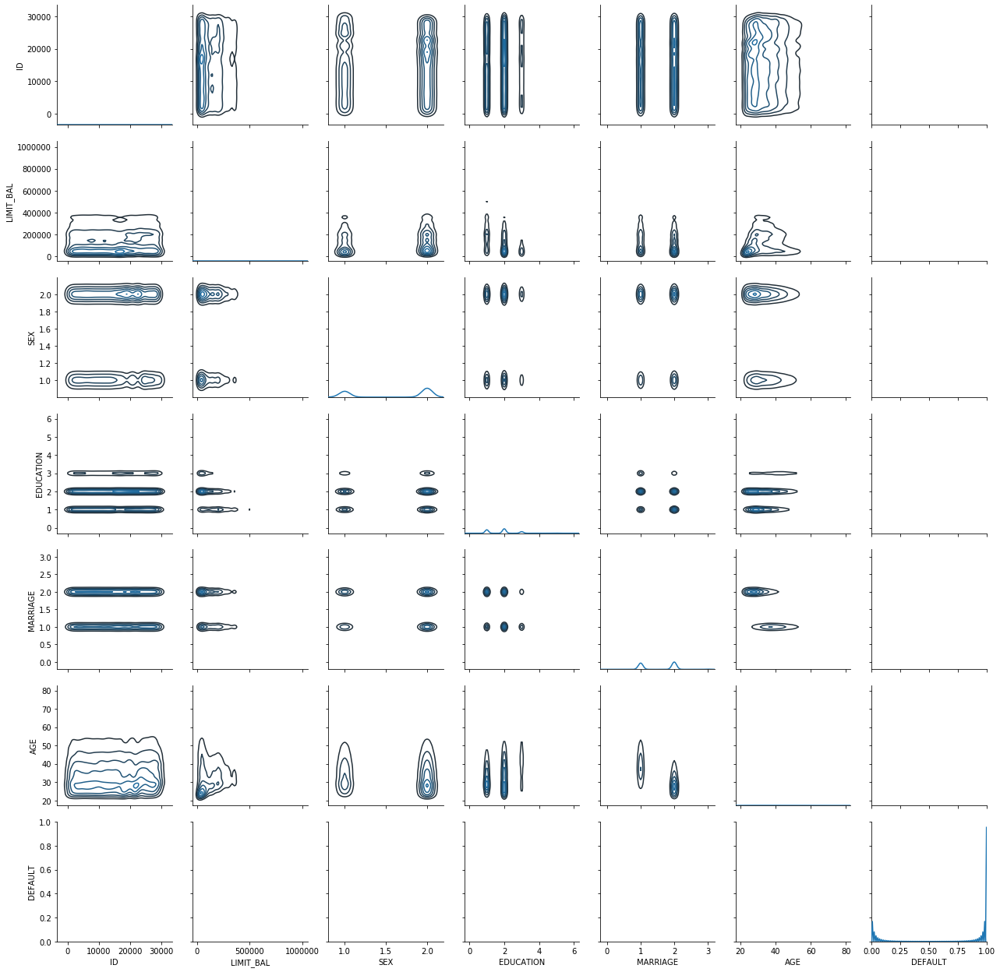

In [21]:
#Pairgrid - Pairplot is built on pairgrid
g = sns.PairGrid(data=ccdefault[["PAY_AMT1","PAY_AMT2","PAY_AMT3","PAY_AMT4","PAY_AMT5","PAY_AMT6"]])
g.map_diag(sns.kdeplot)
g.map_offdiag(sns.kdeplot, n_levels=6);

In [22]:
# feature names as a list
col = ccdefault.columns       # .columns gives columns names in data 
print(col)

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'DEFAULT'],
      dtype='object')


In [24]:
# y includes our labels and x includes our features
y = ccdefault.DEFAULT

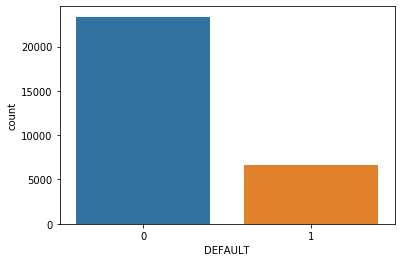

In [25]:
ax = sns.countplot(y,label="Count")

In [28]:
list = ['ID','DEFAULT'] # ID is removed
x = ccdefault.drop(list,axis = 1 )
x.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
0,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
1,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0
2,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0
3,50000.0,2,2,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0
4,50000.0,1,2,1,57,-1,0,-1,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 <a list of 12 Text xticklabel objects>)

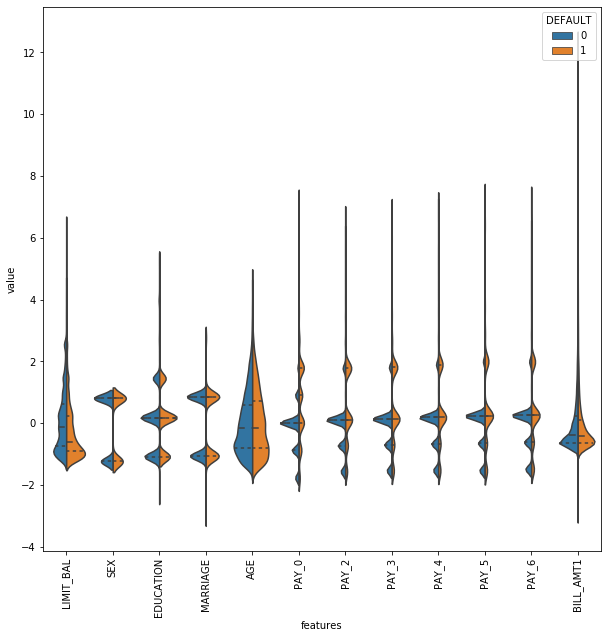

In [31]:
# Voilin plot - First 12 features
data_dia = y
data = x
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2.iloc[:,0:12]],axis=1)
data = pd.melt(data,id_vars="DEFAULT",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="DEFAULT", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 <a list of 11 Text xticklabel objects>)

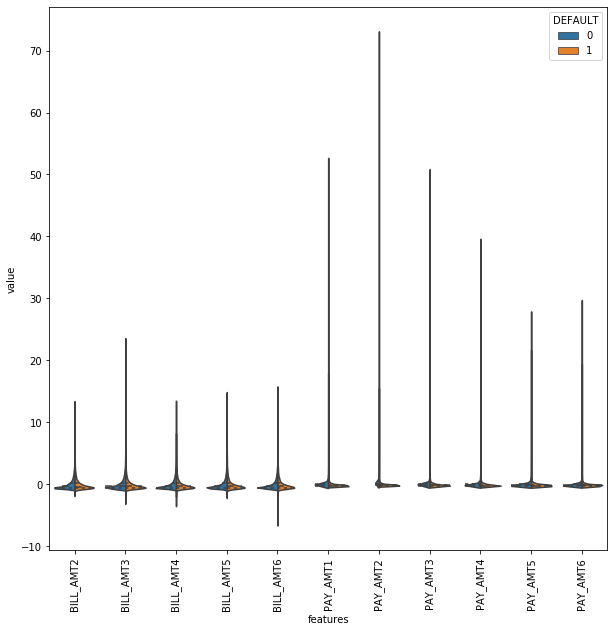

In [32]:
# Second 13 features
data = pd.concat([y,data_n_2.iloc[:,12:23]],axis=1)
data = pd.melt(data,id_vars="DEFAULT",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="DEFAULT", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

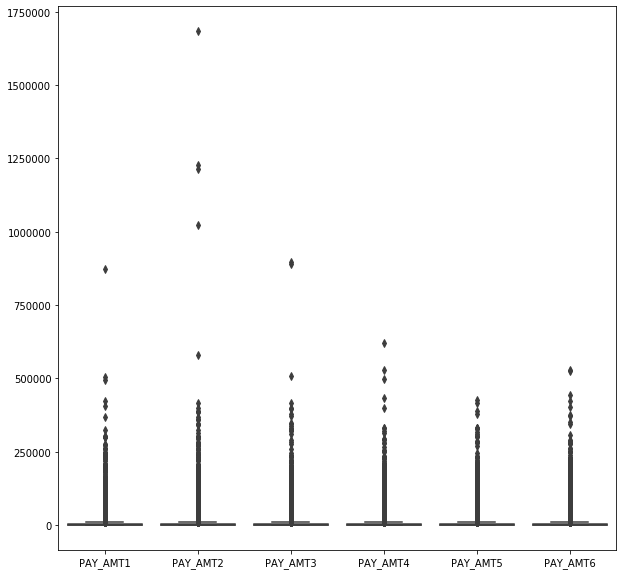

In [47]:
plt.figure(figsize=(10,10))
sns.boxplot(data=ccdefault[["PAY_AMT1","PAY_AMT2","PAY_AMT3","PAY_AMT4","PAY_AMT5","PAY_AMT6"]])

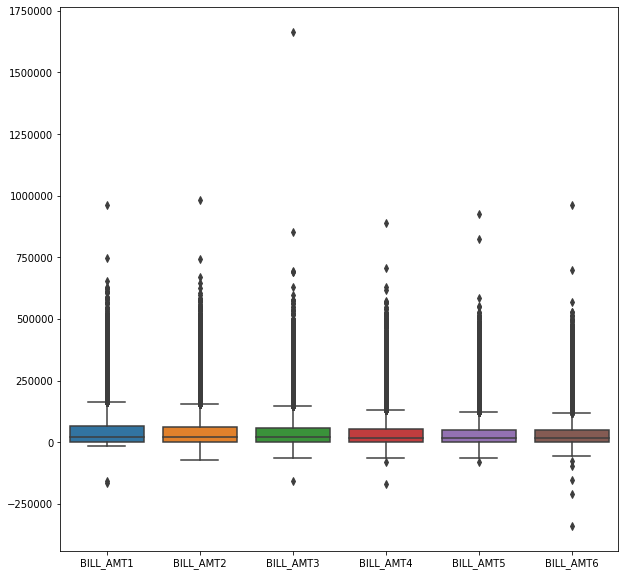

In [48]:
plt.figure(figsize=(10,10))
sns.boxplot(data=ccdefault[["BILL_AMT1","BILL_AMT2","BILL_AMT3","BILL_AMT4","BILL_AMT5","BILL_AMT6"]])

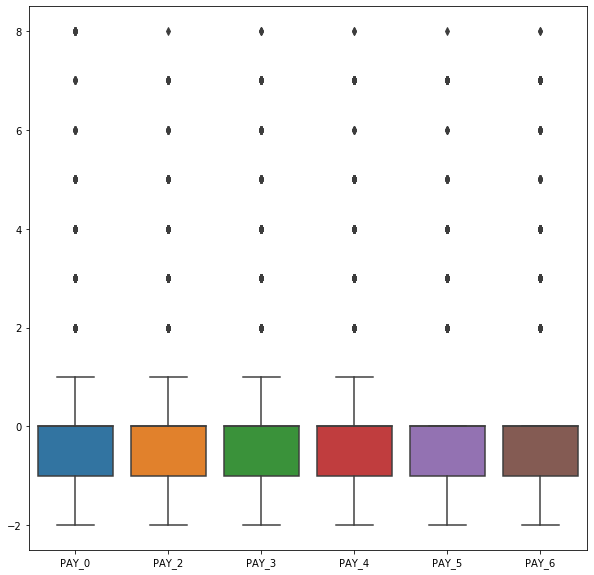

In [49]:
plt.figure(figsize=(10,10))
sns.boxplot(data=ccdefault[["PAY_0","PAY_2","PAY_3","PAY_4","PAY_5","PAY_6"]])

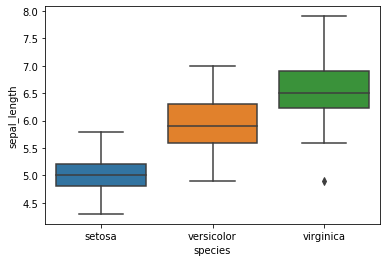

In [38]:
import seaborn as sns
df = sns.load_dataset('iris')
sns.boxplot( x=df["species"], y=df["sepal_length"] )



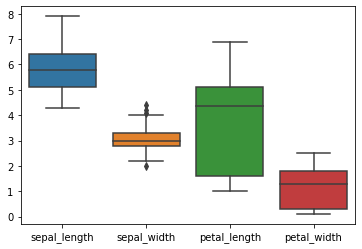

In [41]:
sns.boxplot(data=df)

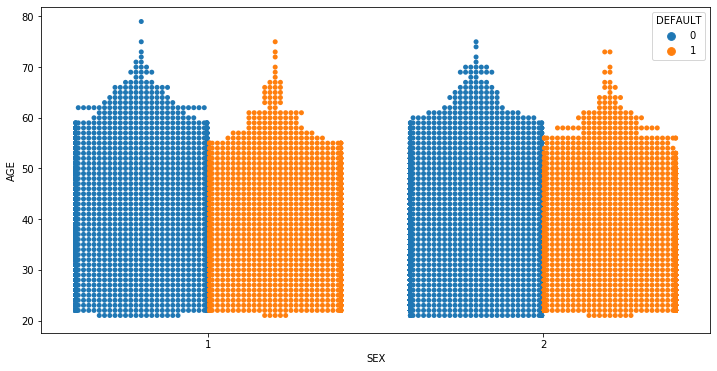

In [52]:
#SWARM PLOTS : For better visualization of distribution data
plt.figure(figsize=(12, 6))
sns.swarmplot(x="SEX", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

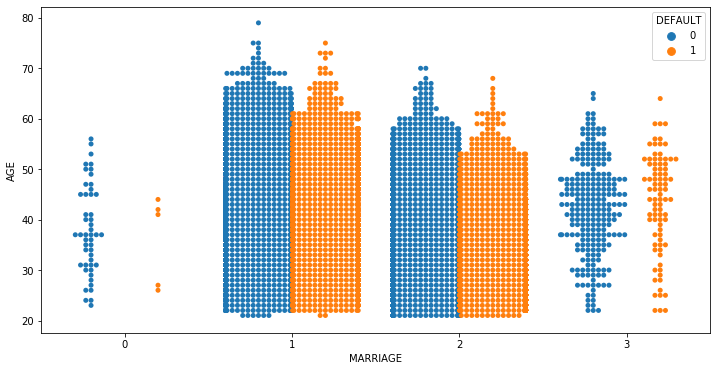

In [53]:
plt.figure(figsize=(12, 6))
sns.swarmplot(x="MARRIAGE", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

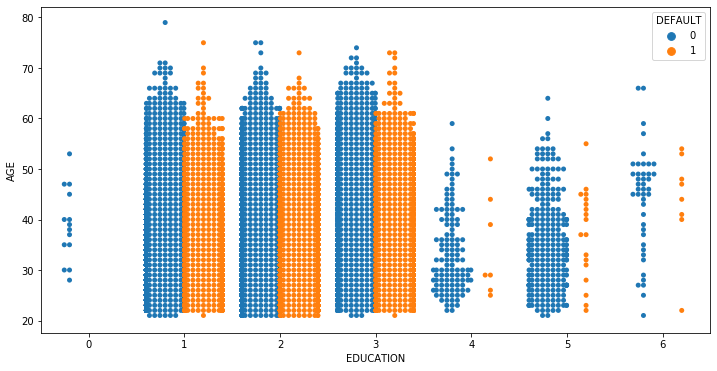

In [54]:
plt.figure(figsize=(12, 6))
sns.swarmplot(x="EDUCATION", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

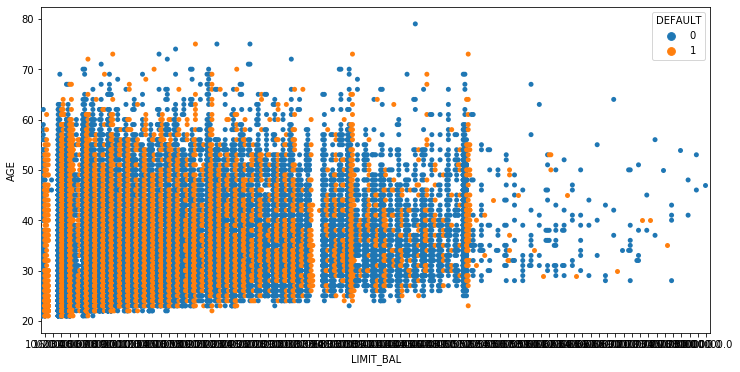

In [55]:
plt.figure(figsize=(12, 6))
sns.swarmplot(x="LIMIT_BAL", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

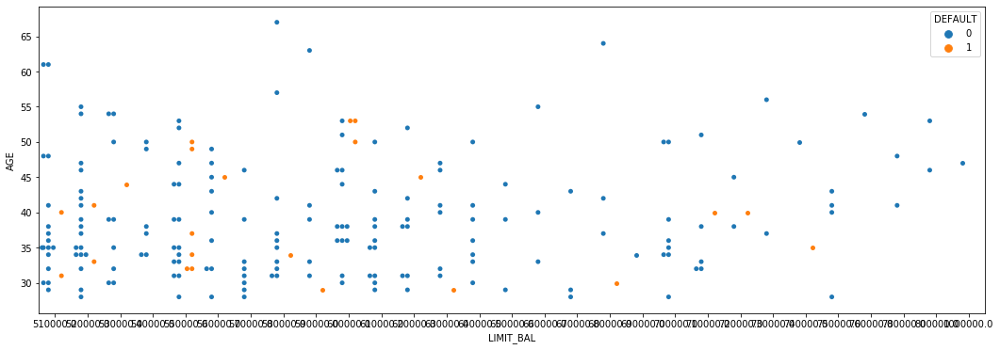

In [70]:
#greater than 50,000 limit balance
grt75filter = ccdefault.LIMIT_BAL > 500000
ccdefaultgt75k=ccdefault[grt75filter]
plt.figure(figsize=(18, 6))
sns.swarmplot(x="LIMIT_BAL", y="AGE", hue='DEFAULT', data=ccdefaultgt75k,dodge=True)#, jitter=True);

In [76]:
bins = [0,50000 , 100000, 250000, 350000,450000,1000000]
labels =[1,2,3,4,5,6]
ccdefault['binned'] = pd.cut(ccdefault['LIMIT_BAL'], bins,labels=labels)

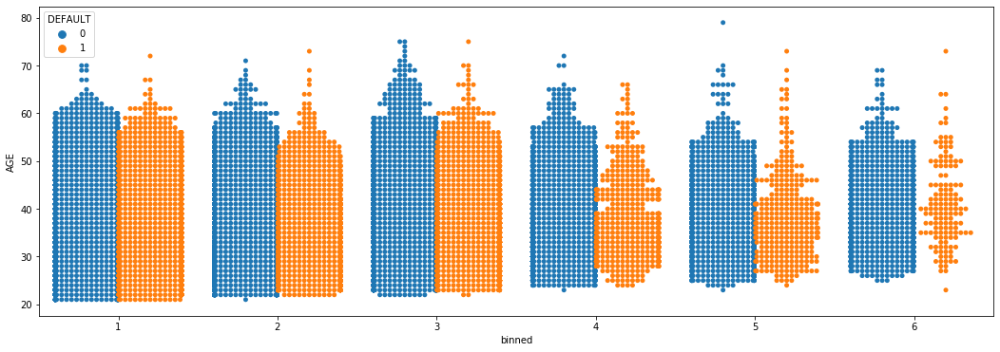

In [77]:
#greater than 50,000 limit balance
plt.figure(figsize=(18, 6))
sns.swarmplot(x="binned", y="AGE", hue='DEFAULT', data=ccdefault,dodge=True)#, jitter=True);

Bins:
    1: 0-50,000
    2: 51,000-100,000
    3: 100,001-250,000
    4: 250,001-350,000
    5: 350,001-450,000
    6: Greater than 450,000

In [16]:
import pandas_profiling
pandas_profiling.ProfileReport(ccdefault)

C:\Users\dkunupudi\AppData\Local\Continuum\anaconda3\lib\site-packages\pandas_profiling\describe.py:392: FutureWarning: The join_axes-keyword is deprecated. Use .reindex or .reindex_like on the result to achieve the same functionality.
  variable_stats = pd.concat(ldesc, join_axes=pd.Index([names]), axis=1)


Number of variables,25
Number of observations,30000
Total Missing (%),0.0%
Total size in memory,5.7 MiB
Average record size in memory,200.0 B
Numeric,18
Categorical,0
Boolean,2
Date,0
Text (Unique),0
Rejected,5


In [9]:
ccdefault.dtypes

ID             int64
LIMIT_BAL    float64
SEX            int64
EDUCATION      int64
MARRIAGE       int64
AGE            int64
PAY_0          int64
PAY_2          int64
PAY_3          int64
PAY_4          int64
PAY_5          int64
PAY_6          int64
BILL_AMT1    float64
BILL_AMT2    float64
BILL_AMT3    float64
BILL_AMT4    float64
BILL_AMT5    float64
BILL_AMT6    float64
PAY_AMT1     float64
PAY_AMT2     float64
PAY_AMT3     float64
PAY_AMT4     float64
PAY_AMT5     float64
PAY_AMT6     float64
DEFAULT        int64
dtype: object

In [31]:
import plotly.express as px
fig = px.parallel_coordinates(ccdefault, color='DEFAULT',
                              dimensions=['SEX', 'AGE','MARRIAGE','EDUCATION','LIMIT_BAL','PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6'],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

In [32]:
# Verifying the data for payment columns
import plotly.express as px
fig = px.parallel_coordinates(ccdefault, color='DEFAULT',
                              dimensions=['PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6'],
                              color_continuous_scale=px.colors.diverging.Tealrose)
fig.show()

Principle component Analysis: 
PCA identifies the combination of components that account for the most variance of the data. The below initial analysis is done to identify the components. In this case, we are checking with MinMaxScaler.

In [89]:
#PCA
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=[0, 1])
data_rescaled = scaler.fit_transform(ccdefault.iloc[1:, 0:24])

TypeError: __init__() got an unexpected keyword argument 'feature_range'

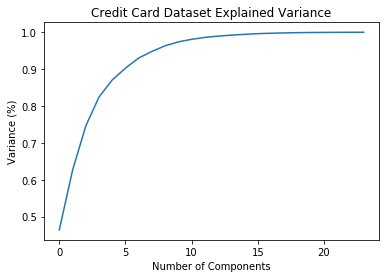

In [76]:
#Fitting the PCA algorithm with our Data
pca = PCA().fit(data_rescaled)
#Plotting the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Credit Card Dataset Explained Variance')
plt.show()

Based on initial analysis, the plot tells us that selecting 12 components we can preserve something around 98.8% or 99% of the total variance of the data. This is a primiliminary analysis.

Before fitting my model, we need to standardize the numerical features and create dummies for my categorical features.